# FFT Base Model
Purpose:
- Simulating good data to mimic a sinusoidal pattern for heart rate
- Using this data to train the ANN model

Notes:
- no downsampling is applied
- only realistically applicable for heart rate, as Dr.Qazi confirmed a sinusoidal pattern

# Imports

In [1]:
# import libraries
import matplotlib.pyplot as plt
import math
import numpy as np
import os
import openpyxl
import pandas as pd
import sklearn
import random
from sklearn.preprocessing import normalize
from scipy.fft import fft, fftfreq, ifft
import ann_one_to_one_functions as ann_functions

# Loading/Preprocessing

In [2]:
#Referencing to local file where UQ vital signs data is located



"""
# Mounting google drive
from google.colab import drive
drive.mount('/content/drive')
"""

"\n# Mounting google drive\nfrom google.colab import drive\ndrive.mount('/content/drive')\n"

In [2]:
# Changing directory to the csv dataset needed
os.chdir("/Users/aaran/MHA_UPLOAD/MHA Data")

In [3]:
# Filtering the data
df = pd.read_csv("uq_vsd_case04_alldata.csv", index_col=False, error_bad_lines=False, usecols=['Time', 'HR'])

df = df.dropna() #drop rows with NaN

case4_filteredData = df.loc[(~df['HR'].isnull())]
case4_filteredData.drop('Time', axis=1, inplace=True)
# print(case4_filteredData.head(10))
# print(case4_filteredData.tail(10))
# print(case4_filteredData.shape)

/var/folders/yv/fxtprh2s52j94nnjg1219s_w0000gn/T/ipykernel_87980/3578882745.py:2: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  df = pd.read_csv("uq_vsd_case04_alldata.csv", index_col=False, error_bad_lines=False, usecols=['Time', 'HR'])


In [4]:
# Filtering the data
df = pd.read_csv("uq_vsd_case04_alldata.csv", index_col=False, error_bad_lines=False, usecols=['Time', 'HR'])

df = df.dropna() #drop rows with NaN

case4_filteredData = df.loc[(~df['HR'].isnull())]
case4_filteredData.drop('Time', axis=1, inplace=True)
print(case4_filteredData.head(10))
print(case4_filteredData.tail(10))
print(case4_filteredData.shape)

/var/folders/yv/fxtprh2s52j94nnjg1219s_w0000gn/T/ipykernel_87980/3523865509.py:2: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  df = pd.read_csv("uq_vsd_case04_alldata.csv", index_col=False, error_bad_lines=False, usecols=['Time', 'HR'])


      HR
0  110.0
1  110.0
2  110.0
3  110.0
4  110.0
5  110.0
6  110.0
7  110.0
8  110.0
9  110.0
           HR
837315  131.0
837316  131.0
837317  131.0
837318  131.0
837319  131.0
837320  131.0
837321  131.0
837322  131.0
837323  131.0
837324  131.0
(837325, 1)


In [5]:
# # plot data
# dataset = case4_filteredData # use if google drive
# values = dataset.values

# # specify columns to plot
# groups = [0,1,2,3]
# i = 1
# for g in groups:
#   plt.subplot(len(groups), 1, i)
#   plt.plot(values[:, g])
#   plt.title(dataset.columns[g], y=0.5, loc='right')
#   i += 1
# # plt.show()

# FFT Forecasting

In [5]:
# Prepping the data
raw_var_data = case4_filteredData['HR'] # replace column name with variable you want

In [6]:
all_modified_data = np.copy(np.array(raw_var_data))
all_modified_data_list = list()

mean = 0
variances = [0.05, 1]
for variance in variances:
  all_modified_data_copy = np.copy(all_modified_data)
  for j in range(0, 10):
    original_data = np.copy(np.array(raw_var_data))
    guass_noise = np.random.normal(0, variance, len(original_data))
    noisy_data = guass_noise + original_data
    all_modified_data_copy = np.append(all_modified_data_copy, noisy_data)
  all_modified_data_list.append(all_modified_data_copy)
print(len(all_modified_data_list[0]))

9210575


AttributeError: module 'matplotlib.pyplot' has no attribute 'set_ylabel'

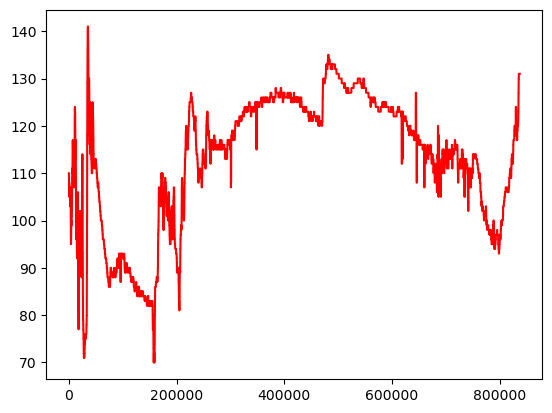

In [13]:
# # Plotting
# for data in all_modified_data_list:
#   plt.plot(data, 'b', label='Modified')
#   plt.plot(original_data, 'r', label='Original')
#   plt.title("FFT Base Model - Heart Rate (HR)")
#   plt.legend()
#   plt.figure(figsize=(20, 8))
#   plt.show()

In [7]:
train_results = dict()
test_results = dict()
long_term_results = dict()
train_features = dict()
train_labels = dict()
test_features = dict()
test_labels = dict()
train_pred = dict()
test_pred = dict()
long_term_pred = dict()

for i in range(len(variances)):
    data = pd.DataFrame(all_modified_data_list[i], columns = ["HR"])
    train_results[str(variances[i])], test_results[str(variances[i])], long_term_results[str(variances[i])], train_features[str(variances[i])], train_labels[str(variances[i])], test_features[str(variances[i])], test_labels[str(variances[i])], train_pred[str(variances[i])], test_pred[str(variances[i])], long_term_pred[str(variances[i])] = ann_functions.test_model_from_df(data, ["HR"], downsample_window = 100, numOfPrevValues = 1000, batch_num = None, epoch_num = 5000, learn_rate = 0.000001, numOfUnits_list = [512])

for variance in train_results.keys():
    print(f'Variance: {variance}')
    print(f'Train Predictions: RMSE: {train_results[variance]["rmse"]}, R^2: {train_results[variance]["r2"]}, MAE: {train_results[variance]["mae"]}, MAPE: {train_results[variance]["mape"]}')
    print(f'Test Predictions: RMSE: {test_results[variance]["rmse"]}, R^2: {test_results[variance]["r2"]}, MAE: {test_results[variance]["mae"]}, MAPE: {test_results[variance]["mape"]}')
    print(f'Long Term Predictions: RMSE: {long_term_results[variance]["rmse"]}, R^2: {long_term_results[variance]["r2"]}, MAE: {long_term_results[variance]["mae"]}, MAPE: {long_term_results[variance]["mape"]}')

for variance in train_pred.keys():
    fig = plt.figure(figsize=(12, 8))
    xtrain_set = np.arange(0, len(train_features[variance]))
    ytrain_set = np.array(train_labels[variance][:])
    plt.plot(xtrain_set, ytrain_set, 'b', label="Actual Train")

    xtest_set = np.arange(len(train_features[variance]),len(train_features[variance]) + len(test_features[variance]))
    ytest_set = np.array(test_labels[variance][:])
    plt.plot(xtest_set, ytest_set, 'r', label="Actual Test")

    pred_train_sig = np.array(train_pred[variance][:])
    plt.plot(xtrain_set, pred_train_sig, 'orange', label="Predicted Train", linestyle="dotted")

    pred_test_sig = np.array(long_term_pred[variance][:])
    plt.plot(xtest_set, pred_test_sig,'green', label="Predicted Test", linestyle="dotted")
    plt.title(f'Heart Rate (HR) Variance: {variance}')
    plt.legend()
    plt.show()

# data = pd.DataFrame(all_modified_data_list[0], columns = ["HR"])
# ann_functions.test_model_from_df(data, ["HR"], downsample_window = 100, numOfPrevValues = 1000, batch_num = None, epoch_num = 5000, learn_rate = 0.000001, numOfUnits_list = [512])

/Users/aaran/MHA_Upload/Python Code/model_tools.py:49: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(row, ignore_index = True)
/Users/aaran/MHA_Upload/Python Code/model_tools.py:49: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(row, ignore_index = True)
/Users/aaran/MHA_Upload/Python Code/model_tools.py:49: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(row, ignore_index = True)
/Users/aaran/MHA_Upload/Python Code/model_tools.py:49: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(row, ignore_index = True)
/Users/aaran/MHA_Upload/Python Code/

TRAIN
This is shape of train features array: (72684, 1000, 1)
This is shape of train labels array: (72684, 1)
TEST
This is shape of test features array: (17421, 1000, 1)
This is shape of test labels array: (17421, 1)
Metal device set to: Apple M1

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



2023-01-18 09:55:19.363704: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-01-18 09:55:19.363730: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Epoch 1/5000


2023-01-18 09:55:19.692489: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-01-18 09:55:20.374895: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1590/1590 [==============================] - ETA: 0s - loss: 0.0127 - accuracy: 0.0000e+00

2023-01-18 09:56:53.922539: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1590/1590 [==============================] - 106s 66ms/step - loss: 0.0127 - accuracy: 0.0000e+00 - val_loss: 0.0025 - val_accuracy: 0.0000e+00
Epoch 2/5000
1590/1590 [==============================] - 106s 66ms/step - loss: 0.0021 - accuracy: 0.0000e+00 - val_loss: 0.0014 - val_accuracy: 0.0000e+00
Epoch 3/5000
1590/1590 [==============================] - 113s 71ms/step - loss: 0.0014 - accuracy: 0.0000e+00 - val_loss: 9.9630e-04 - val_accuracy: 0.0000e+00
Epoch 4/5000
1590/1590 [==============================] - 115s 72ms/step - loss: 0.0010 - accuracy: 0.0000e+00 - val_loss: 7.5242e-04 - val_accuracy: 0.0000e+00
Epoch 5/5000
1590/1590 [==============================] - 115s 72ms/step - loss: 8.0916e-04 - accuracy: 0.0000e+00 - val_loss: 6.1531e-04 - val_accuracy: 0.0000e+00
Epoch 6/5000
1590/1590 [==============================] - 113s 71ms/step - loss: 6.8338e-04 - accuracy: 0.0000e+00 - val_loss: 5.7824e-04 - val_accuracy: 0.0000e+00
Epoch 6: early stopping
Model: "sequential"
___

2023-01-18 10:06:27.864588: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


2272/2272 [==============================] - 42s 18ms/step
RMSE:  0.024817924255846543
R2 (Sklearn): 0.9799112632572108
MAE: 0.015596207586289402
MAPE: 0.02819126056992175
545/545 [==============================] - 9s 17ms/step
RMSE:  0.025033633447934193
R2 (Sklearn): 0.9792567346456864
MAE: 0.015717430153564964
MAPE: 0.028490705801579592
0
1/1 [==============================] - 0s 72ms/step
1
1/1 [==============================] - 0s 15ms/step
2
1/1 [==============================] - 0s 15ms/step
3
1/1 [==============================] - 0s 17ms/step
4
1/1 [==============================] - 0s 14ms/step
5
1/1 [==============================] - 0s 15ms/step
6
1/1 [==============================] - 0s 18ms/step
7
1/1 [==============================] - 0s 15ms/step
8
1/1 [==============================] - 0s 18ms/step
9
1/1 [==============================] - 0s 15ms/step
10
1/1 [==============================] - 0s 17ms/step
11
1/1 [==============================] - 0s 18ms/step
12
1/1 [

Exception ignored in: <function WeakKeyDictionary.__init__.<locals>.remove at 0x13a08f370>
Traceback (most recent call last):
  File "/Users/aaran/opt/anaconda3/envs/tensorflow/lib/python3.10/weakref.py", line 370, in remove
    def remove(k, selfref=ref(self)):
KeyboardInterrupt: 


1/1 [==============================] - 0s 20ms/step
2140
1/1 [==============================] - 0s 30ms/step
2141
1/1 [==============================] - 0s 23ms/step
2142
1/1 [==============================] - 0s 20ms/step
2143
1/1 [==============================] - 0s 21ms/step
2144
1/1 [==============================] - 0s 21ms/step
2145
1/1 [==============================] - 0s 21ms/step
2146
1/1 [==============================] - 0s 16ms/step
2147
1/1 [==============================] - 0s 16ms/step
2148
1/1 [==============================] - 0s 21ms/step
2149
1/1 [==============================] - 0s 15ms/step
2150
1/1 [==============================] - 0s 16ms/step
2151
1/1 [==============================] - 0s 17ms/step
2152
1/1 [==============================] - 0s 14ms/step
2153
1/1 [==============================] - 0s 14ms/step
2154
1/1 [==============================] - 0s 14ms/step
2155
1/1 [==============================] - 0s 14ms/step
2156
1/1 [==========================

In [11]:
data = pd.DataFrame(all_modified_data_list[0], columns = ["HR"])
print(data)

                 HR
0        110.000000
1        110.000000
2        110.000000
3        110.000000
4        110.000000
...             ...
9210570  130.965642
9210571  131.007827
9210572  131.086725
9210573  130.968354
9210574  130.973506

[9210575 rows x 1 columns]
